<a href="https://colab.research.google.com/github/deepzsenu/Feature-Detection-Of-areal-dataset-sattelite-image-/blob/main/feature_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!wget https://senseflycom.s3.amazonaws.com/datasets/soda-hq/EP-00-00012_0119.kml

--2020-12-09 09:12:49--  https://senseflycom.s3.amazonaws.com/datasets/soda-hq/EP-00-00012_0119.kml
Resolving senseflycom.s3.amazonaws.com (senseflycom.s3.amazonaws.com)... 52.219.47.89
Connecting to senseflycom.s3.amazonaws.com (senseflycom.s3.amazonaws.com)|52.219.47.89|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 883449 (863K) [application/octet-stream]
Saving to: ‘EP-00-00012_0119.kml.1’

EP-00-00012_0119.km 100%[===================>] 862.74K  1.66MB/s    in 0.5s    

2020-12-09 09:12:50 (1.66 MB/s) - ‘EP-00-00012_0119.kml.1’ saved [883449/883449]



In [ ]:
!wget https://senseflycom.s3.amazonaws.com/datasets/soda-hq/161104_hq_group1_densified_point_cloud.las

--2020-12-09 09:12:50--  https://senseflycom.s3.amazonaws.com/datasets/soda-hq/161104_hq_group1_densified_point_cloud.las
Resolving senseflycom.s3.amazonaws.com (senseflycom.s3.amazonaws.com)... 52.219.47.89
Connecting to senseflycom.s3.amazonaws.com (senseflycom.s3.amazonaws.com)|52.219.47.89|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 619682175 (591M) [application/octet-stream]
Saving to: ‘161104_hq_group1_densified_point_cloud.las.1’

161104_hq_group1_de 100%[===================>] 590.97M  29.3MB/s    in 21s     

2020-12-09 09:13:12 (28.3 MB/s) - ‘161104_hq_group1_densified_point_cloud.las.1’ saved [619682175/619682175]



In [ ]:
!wget https://senseflycom.s3.amazonaws.com/datasets/soda-hq/rgb-images.zip

--2020-12-09 09:13:12--  https://senseflycom.s3.amazonaws.com/datasets/soda-hq/rgb-images.zip
Resolving senseflycom.s3.amazonaws.com (senseflycom.s3.amazonaws.com)... 52.219.140.41
Connecting to senseflycom.s3.amazonaws.com (senseflycom.s3.amazonaws.com)|52.219.140.41|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 512188279 (488M) [application/octet-stream]
Saving to: ‘rgb-images.zip.2’

rgb-images.zip.2    100%[===================>] 488.46M  30.0MB/s    in 17s     

2020-12-09 09:13:29 (28.3 MB/s) - ‘rgb-images.zip.2’ saved [512188279/512188279]



In [ ]:
!wget https://senseflycom.s3.amazonaws.com/datasets/soda-hq/map_orthomosaic.zip

--2020-12-09 09:13:30--  https://senseflycom.s3.amazonaws.com/datasets/soda-hq/map_orthomosaic.zip
Resolving senseflycom.s3.amazonaws.com (senseflycom.s3.amazonaws.com)... 52.219.75.54
Connecting to senseflycom.s3.amazonaws.com (senseflycom.s3.amazonaws.com)|52.219.75.54|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 690880107 (659M) [application/octet-stream]
Saving to: ‘map_orthomosaic.zip.2’

map_orthomosaic.zip 100%[===================>] 658.87M  29.7MB/s    in 23s     

2020-12-09 09:13:53 (28.8 MB/s) - ‘map_orthomosaic.zip.2’ saved [690880107/690880107]



In [ ]:
from osgeo import gdal
import numpy as np
ds = gdal.Open("/content/Data_set/Map (orthomosaic)/161104_hq_transparent_mosaic_group1.tif")
Map = np.array(ds.GetRasterBand(1).ReadAsArray())
Map.shape

(25388, 26747)

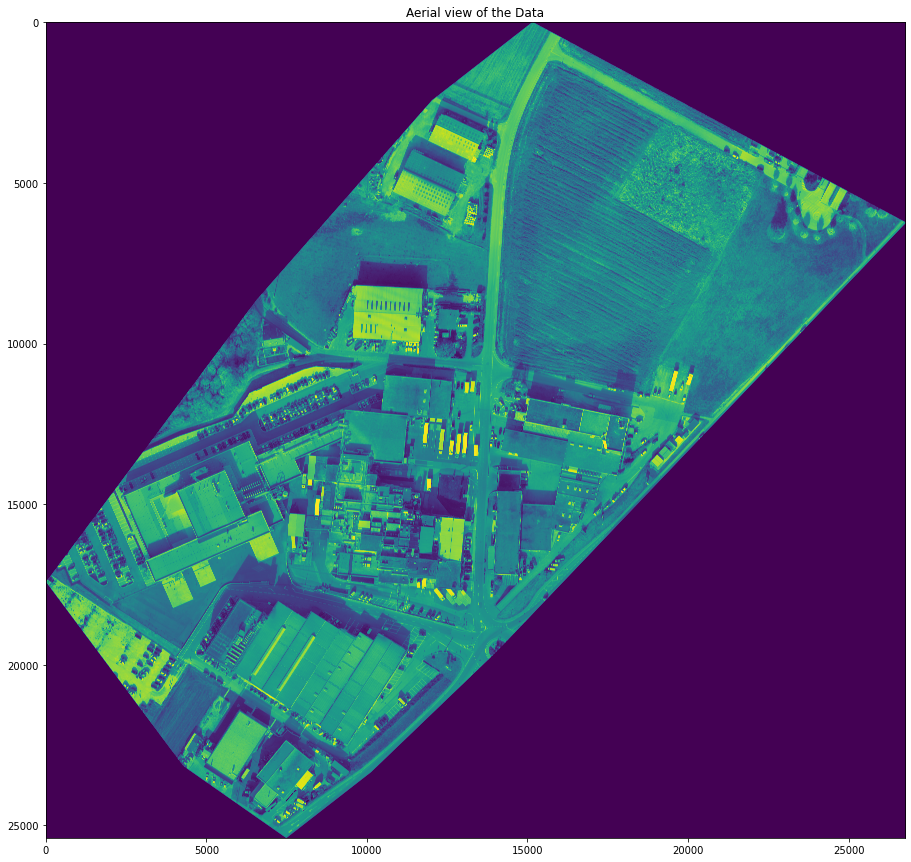

In [ ]:
import matplotlib.pyplot as plt
fig = plt.figure(figsize=(20,15))

ax = fig.add_subplot(111)
ax.set_title('Aerial view of the Data')
plt.imshow(Map)
ax.set_aspect('equal')

#### converting large image and resizing

In [ ]:
% matplotlib inline
import skimage
print(skimage.__version__)
import numpy as np
from PIL import Image, ImageFont, ImageDraw
from PIL.ImageChops import add, subtract, multiply, difference, screen
import PIL.ImageStat as stat
from skimage.io import imread, imsave, imshow, show, imread_collection, imshow_collection
from skimage import color, viewer, exposure, img_as_float, data
from skimage.transform import SimilarityTransform, warp, swirl
from skimage.util import invert, random_noise, montage
import matplotlib.image as mpimg
import matplotlib.pylab as plt
from scipy.ndimage import affine_transform, zoom
from scipy import misc

0.16.2


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:9: UserWarning: Viewer requires Qt
  if __name__ == '__main__':


In [ ]:
import numpy as np
from PIL import Image
Image.MAX_IMAGE_PIXELS = None

im = Image.open('/content/Data_set/Map (orthomosaic)/161104_hq.jpg')


In [ ]:
im.convert('RGB').save("map.png")

In [ ]:
im = Image.open('/content/map.png')

In [ ]:
print(im.width, im.height)

26747 25388


In [ ]:
im_small = im.resize((im.width//10, im.height//10), Image.ANTIALIAS)

In [ ]:
print(im_small.width, im_small.height)

2674 2538


In [ ]:
im_small.convert('RGB').save("/content/Data_set/small_map.png")

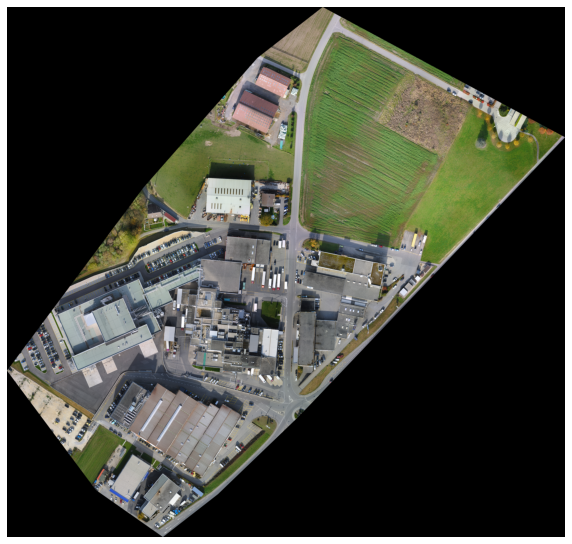

In [ ]:
image = mpimg.imread("/content/Data_set/small_map.png") # read the image from disk as a numpy ndarray
#print(image.shape, im.dtype, type(im)) # this image contains an α channel, hence num_channels= 4
# (960, 1280, 4) float32 <class 'numpy.ndarray'>
plt.figure(figsize=(10,10))
plt.imshow(image) # display the image
plt.axis('off')
plt.show()

In [ ]:
image = Image.open('/content/Data_set/small_map.png')


In [ ]:
image.convert('RGB').save("/content/Data_set/small_map.jpg")

Now we have both the file formates jpg and png of the small map image

---



### Performing the operations

In [ ]:
% matplotlib inline
from matplotlib import pylab as pylab
from skimage.io import imread
from skimage.color import rgb2gray
from skimage.feature import corner_harris, corner_subpix, corner_peaks
from skimage.transform import warp, SimilarityTransform, AffineTransform, resize
import cv2
import numpy as np
from skimage import data
from skimage.util import img_as_float
from skimage.exposure import rescale_intensity
from skimage.measure import ransac

##### Separating the RGB channels of an image

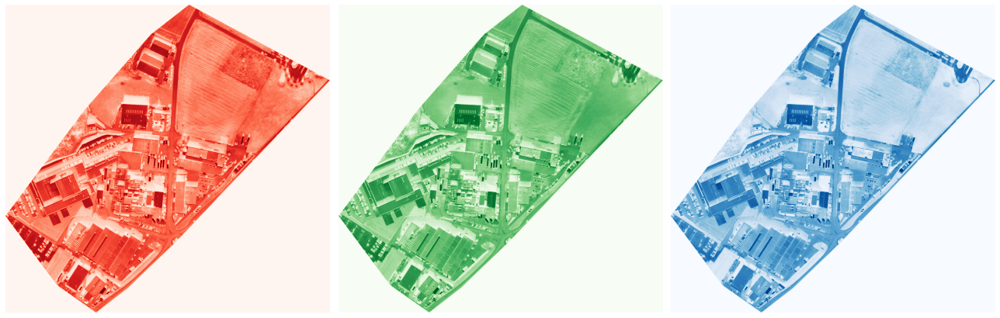

In [ ]:
im = Image.open("/content/Data_set/small_map.jpg")
ch_r, ch_g, ch_b = im.split() # split the RGB image into 3 channels: R, G and B
# we shall use matplotlib to display the channels
plt.figure(figsize=(18,6))
plt.subplot(1,3,1); plt.imshow(ch_r, cmap=plt.cm.Reds); plt.axis('off')
plt.subplot(1,3,2); plt.imshow(ch_g, cmap=plt.cm.Greens); plt.axis('off')
plt.subplot(1,3,3); plt.imshow(ch_b, cmap=plt.cm.Blues); plt.axis('off')
plt.tight_layout()
plt.show()

#### With sub-pixel accuracy

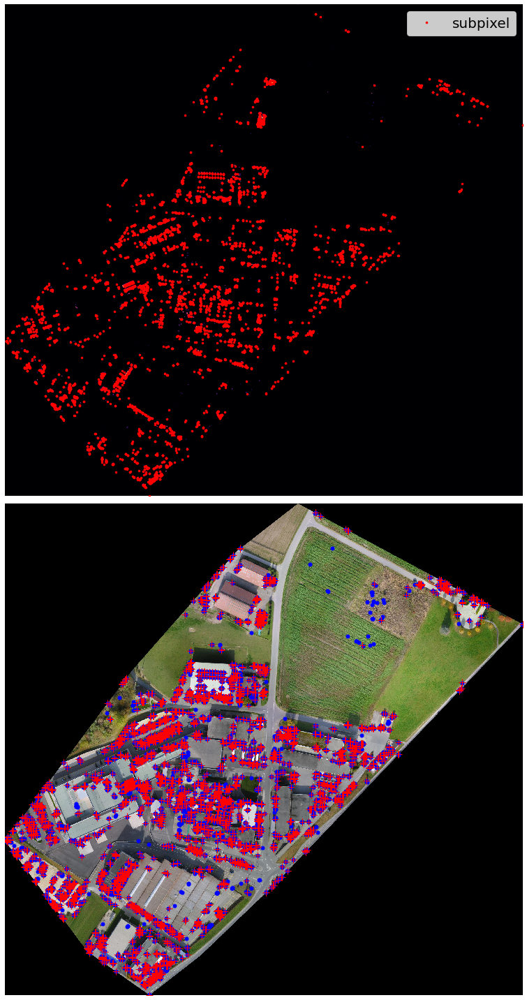

(None, None)

In [ ]:
image = imread('/content/Data_set/small_map.jpg')
image_gray = rgb2gray(image)
coordinates = corner_harris(image_gray, k =0.001)
coordinates[coordinates > 0.03*coordinates.max()] = 255 # threshold for an optimal value, depends on the image
corner_coordinates = corner_peaks(coordinates)
coordinates_subpix = corner_subpix(image_gray, corner_coordinates, window_size=11)
pylab.figure(figsize=(20,20))
pylab.subplot(211), pylab.imshow(coordinates, cmap='inferno')
pylab.plot(coordinates_subpix[:, 1], coordinates_subpix[:, 0], 'r.', markersize=5, label='subpixel')
pylab.legend(prop={'size': 20}), pylab.axis('off')
pylab.subplot(212), pylab.imshow(image, interpolation='nearest')
pylab.plot(corner_coordinates[:, 1], corner_coordinates[:, 0], 'bo', markersize=5)
pylab.plot(coordinates_subpix[:, 1], coordinates_subpix[:, 0], 'r+', markersize=10), pylab.axis('off')
pylab.tight_layout(), pylab.show()

#### Robust image matching using the RANSAC algorithm and Harris Corner features

In [ ]:
image = rgb2gray(img_as_float(imread('/content/Data_set/small_map.jpg')))
image_original = np.zeros(list(image.shape) + [3])
image_original[..., 0] = image
gradient_row, gradient_col = (np.mgrid[0:image_original.shape[0], 0:image_original.shape[1]] / float(image_original.shape[0]))
image_original[..., 1] = gradient_row
image_original[..., 2] = gradient_col
image_original = rescale_intensity(image_original)
image_original_gray = rgb2gray(image_original)
affine_trans = AffineTransform(scale=(0.8, 0.9), rotation=0.1, translation=(120, -20))
image_warped = warp(image_original, affine_trans .inverse, output_shape=image_original.shape)
image_warped_gray = rgb2gray(image_warped)
coordinates = corner_harris(image_original_gray)
coordinates[coordinates > 0.01*coordinates.max()] = 1
coordinates_original = corner_peaks(coordinates, threshold_rel=0.0001, min_distance=5)
coordinates = corner_harris(image_warped_gray)
coordinates[coordinates > 0.01*coordinates.max()] = 1
coordinates_warped = corner_peaks(coordinates, threshold_rel=0.0001, min_distance=5)
coordinates_original_subpix = corner_subpix(image_original_gray, coordinates_original, window_size=9)
coordinates_warped_subpix = corner_subpix(image_warped_gray, coordinates_warped, window_size=9)

In [ ]:
def gaussian_weights(window_ext, sigma=1):
    y, x = np.mgrid[-window_ext:window_ext+1, -window_ext:window_ext+1]
    g_w = np.zeros(y.shape, dtype = np.double)
    g_w[:] = np.exp(-0.5 * (x**2 / sigma**2 + y**2 / sigma**2))
    g_w /= 2 * np.pi * sigma * sigma
    return g_w

In [ ]:
def match_corner(coordinates, window_ext=3):
    row, col = np.round(coordinates).astype(np.intp)
    window_original = image_original[row-window_ext:row+window_ext+1, col-window_ext:col+window_ext+1, :]
    weights = gaussian_weights(window_ext, 3)
    weights = np.dstack((weights, weights, weights))
    SSDs = []
    for coord_row, coord_col in coordinates_warped:
        window_warped = image_warped[coord_row-window_ext:coord_row+window_ext+1,
        coord_col-window_ext:coord_col+window_ext+1, :]
        if window_original.shape == window_warped.shape:
            SSD = np.sum(weights * (window_original - window_warped)**2)
            SSDs.append(SSD)
    min_idx = np.argmin(SSDs) if len(SSDs) > 0 else -1
    return coordinates_warped_subpix[min_idx] if min_idx >= 0 else [None]

In [ ]:
from skimage.feature import (match_descriptors, corner_peaks, corner_harris, plot_matches, BRIEF)
source, destination = [], []
for coordinates in coordinates_original_subpix:
    coordinates1 = match_corner(coordinates)
    if any(coordinates1) and len(coordinates1) > 0 and not all(np.isnan(coordinates1)):
        source.append(coordinates)
        destination.append(coordinates1)
source = np.array(source)
destination = np.array(destination)
model = AffineTransform()
model.estimate(source, destination)
model_robust, inliers = ransac((source, destination), AffineTransform, min_samples=3, residual_threshold=2, max_trials=100)
outliers = inliers == False
print(affine_trans.scale, affine_trans.translation, affine_trans.rotation)
print(model.scale, model.translation, model.rotation)
print(model_robust.scale, model_robust.translation, model_robust.rotation)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: RuntimeWarning: overflow encountered in long_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


(0.8, 0.9) [120. -20.] 0.09999999999999999
(0.8991902823166497, 0.7976065903318682) [-15.9928091  118.91045871] -0.09804479829000956
(0.9000267361889278, 0.800008783677576) [-20.14085442 119.96152083] -0.0999703296536497


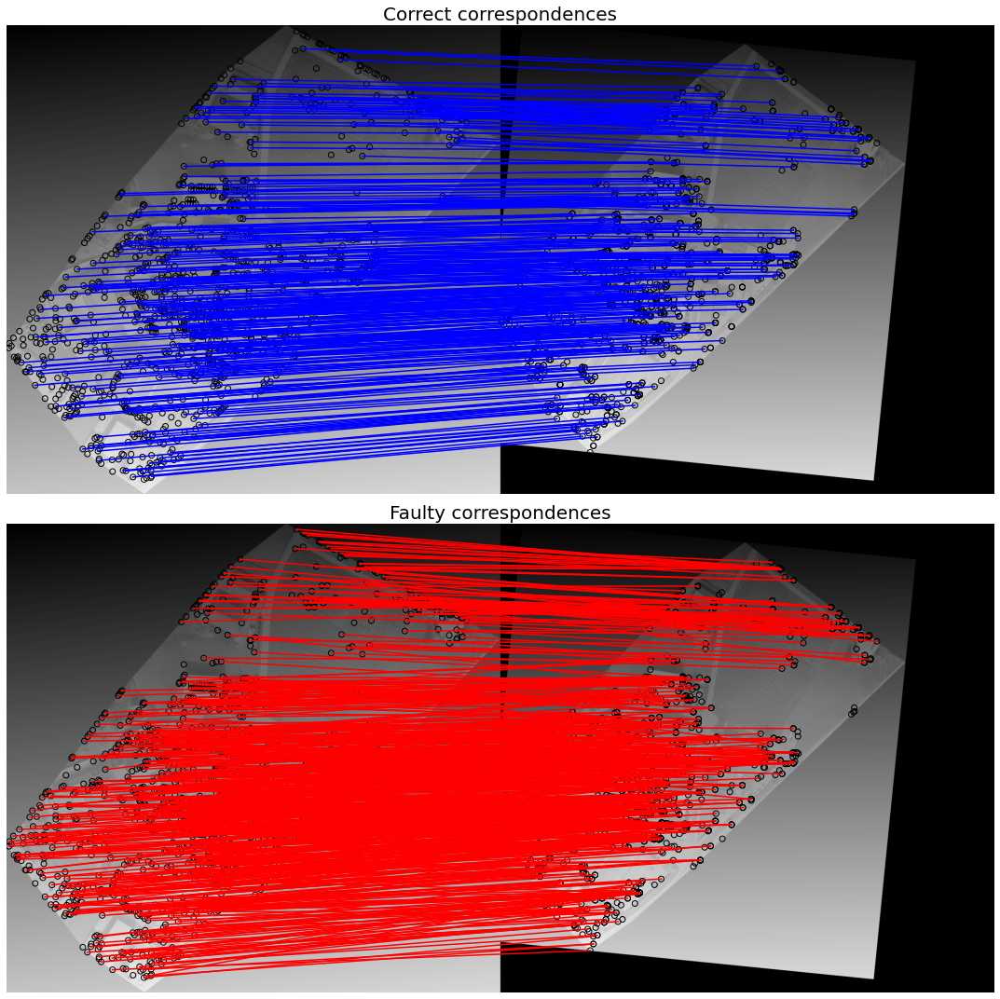

(None, None)

In [ ]:
fig, axes = pylab.subplots(nrows=2, ncols=1, figsize=(20,15))
pylab.gray()
inlier_idxs = np.nonzero(inliers)[0]
plot_matches(axes[0], image_original_gray, image_warped_gray, source, destination, np.column_stack((inlier_idxs, inlier_idxs)),matches_color='b')
axes[0].axis('off'), axes[0].set_title('Correct correspondences', size=20)
outlier_idxs = np.nonzero(outliers)[0]
plot_matches(axes[1], image_original_gray, image_warped_gray, source, destination, np.column_stack((outlier_idxs, outlier_idxs)), matches_color='r')
axes[1].axis('off'), axes[1].set_title('Faulty correspondences', size=20)
fig.tight_layout(), pylab.show()

#### Matching images with BRIEF binary descriptors 

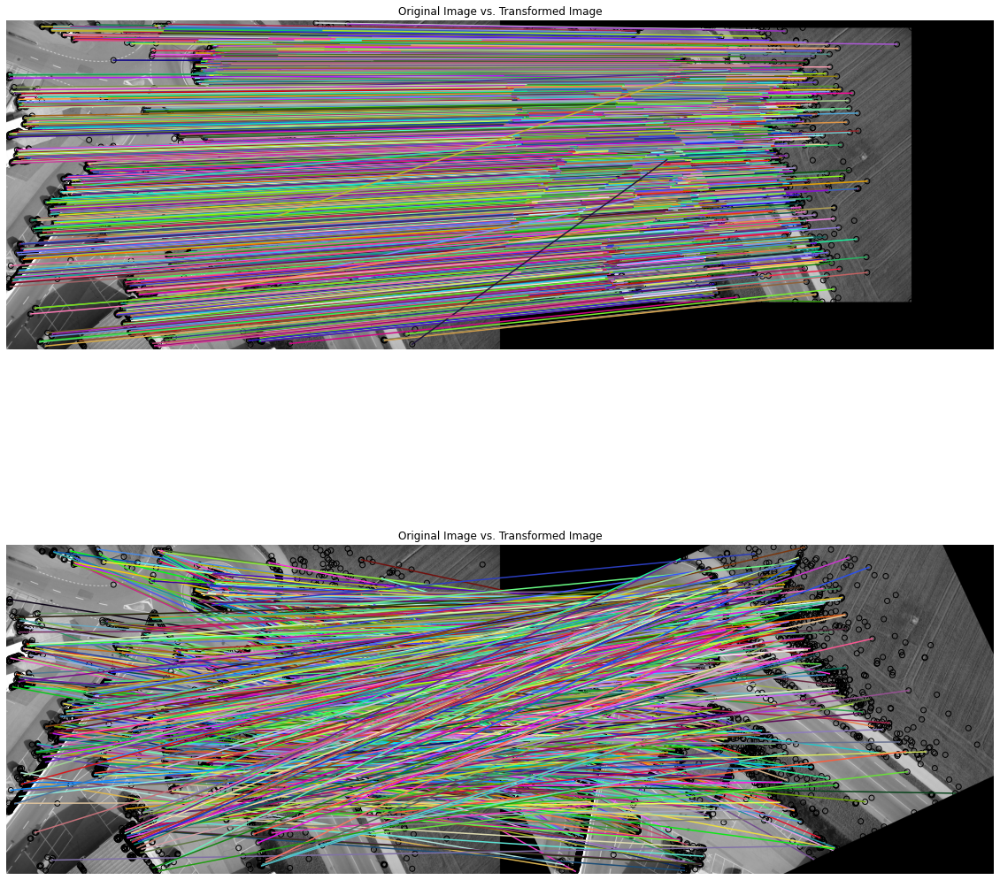

In [ ]:
from skimage import transform as transform
from skimage.feature import (match_descriptors, corner_peaks, corner_harris, plot_matches, BRIEF)
img1 = rgb2gray(imread('/content/Data_set/RGB Images/EP-00-00012_0119_0003.JPG')) 
affine_trans = transform.AffineTransform(scale=(1.2, 1.2), translation=(0,-100))
img2 = transform.warp(img1, affine_trans)
img3 = transform.rotate(img1, 25)
coords1, coords2, coords3 = corner_harris(img1), corner_harris(img2), corner_harris(img3)
coords1[coords1 > 0.01*coords1.max()] = 1
coords2[coords2 > 0.01*coords2.max()] = 1
coords3[coords3 > 0.01*coords3.max()] = 1
keypoints1 = corner_peaks(coords1, min_distance=5)
keypoints2 = corner_peaks(coords2, min_distance=5)
keypoints3 = corner_peaks(coords3, min_distance=5)
extractor = BRIEF()
extractor.extract(img1, keypoints1)
keypoints1, descriptors1 = keypoints1[extractor.mask], extractor.descriptors
extractor.extract(img2, keypoints2)
keypoints2, descriptors2 = keypoints2[extractor.mask], extractor.descriptors
extractor.extract(img3, keypoints3)
keypoints3, descriptors3 = keypoints3[extractor.mask], extractor.descriptors
matches12 = match_descriptors(descriptors1, descriptors2, cross_check=True)
matches13 = match_descriptors(descriptors1, descriptors3, cross_check=True)
fig, axes = pylab.subplots(nrows=2, ncols=1, figsize=(20,20))
pylab.gray(), plot_matches(axes[0], img1, img2, keypoints1, keypoints2, matches12)
axes[0].axis('off'), axes[0].set_title("Original Image vs. Transformed Image")
plot_matches(axes[1], img1, img3, keypoints1, keypoints3, matches13)
axes[1].axis('off'), axes[1].set_title("Original Image vs. Transformed Image")
pylab.show()

#### Matching with ORB feature detector and binary descriptor

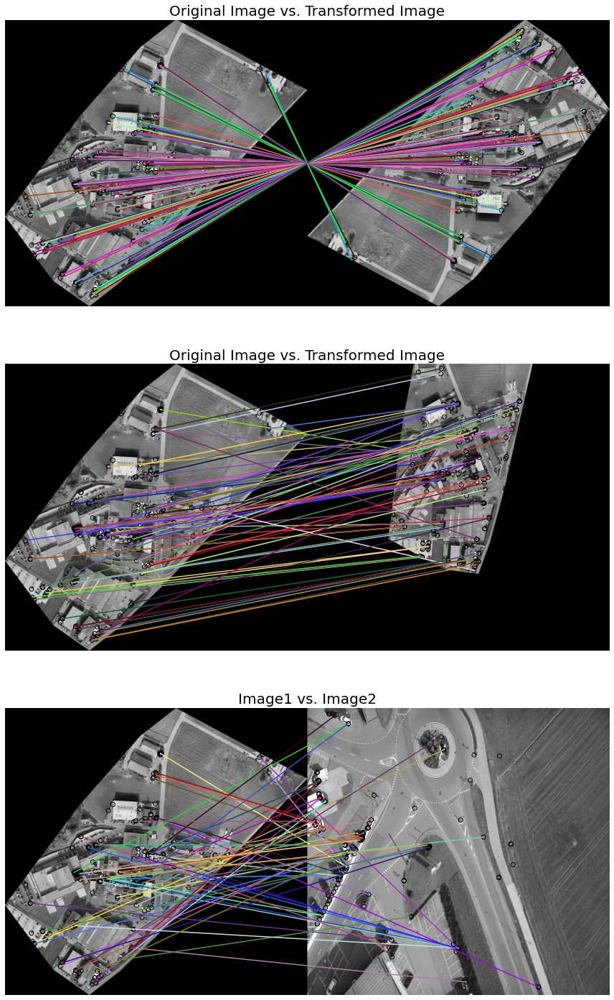

In [ ]:
from skimage import transform as transform
from skimage.feature import (match_descriptors, ORB, plot_matches)
img1 = rgb2gray(imread('/content/Data_set/small_map.jpg'))
img2 = transform.rotate(img1, 180)
affine_trans = transform.AffineTransform(scale=(1.3, 1.1), rotation=0.5, translation=(0, -200))
img3 = transform.warp(img1, affine_trans)
img4 = transform.resize(rgb2gray(imread('/content/Data_set/RGB Images/EP-00-00012_0119_0003.JPG')), img1.shape, anti_aliasing=True)
descriptor_extractor = ORB(n_keypoints=200)
descriptor_extractor.detect_and_extract(img1)
keypoints1, descriptors1 = descriptor_extractor.keypoints, descriptor_extractor.descriptors
descriptor_extractor.detect_and_extract(img2)
keypoints2, descriptors2 = descriptor_extractor.keypoints, descriptor_extractor.descriptors
descriptor_extractor.detect_and_extract(img3)
keypoints3, descriptors3 = descriptor_extractor.keypoints, descriptor_extractor.descriptors
descriptor_extractor.detect_and_extract(img4)
keypoints4, descriptors4 = descriptor_extractor.keypoints, descriptor_extractor.descriptors
matches12 = match_descriptors(descriptors1, descriptors2, cross_check=True)
matches13 = match_descriptors(descriptors1, descriptors3, cross_check=True)
matches14 = match_descriptors(descriptors1, descriptors4, cross_check=True)
fig, axes = pylab.subplots(nrows=3, ncols=1, figsize=(20,25))
pylab.gray()
plot_matches(axes[0], img1, img2, keypoints1, keypoints2, matches12)
axes[0].axis('off'), axes[0].set_title("Original Image vs. Transformed Image", size=20)
plot_matches(axes[1], img1, img3, keypoints1, keypoints3, matches13)
axes[1].axis('off'), axes[1].set_title("Original Image vs. Transformed Image", size=20)
plot_matches(axes[2], img1, img4, keypoints1, keypoints4, matches14)
axes[2].axis('off'), axes[2].set_title("Image1 vs. Image2", size=20)
pylab.show()

### detecting lines and circles

In [ ]:
import numpy as np
from skimage.transform import (hough_line, hough_line_peaks, hough_circle, hough_circle_peaks)
from skimage.draw import circle_perimeter
from skimage.feature import canny
from skimage.data import astronaut
from skimage.io import imread, imsave
from skimage.color import rgb2gray, gray2rgb, label2rgb
from skimage import img_as_float
from skimage.morphology import skeletonize
from skimage import data, img_as_float
import matplotlib.pyplot as plt
from matplotlib import cm
from skimage.filters import sobel, threshold_otsu
from skimage.feature import canny
from skimage.segmentation import felzenszwalb, slic, quickshift, watershed
from skimage.segmentation import mark_boundaries, find_boundaries

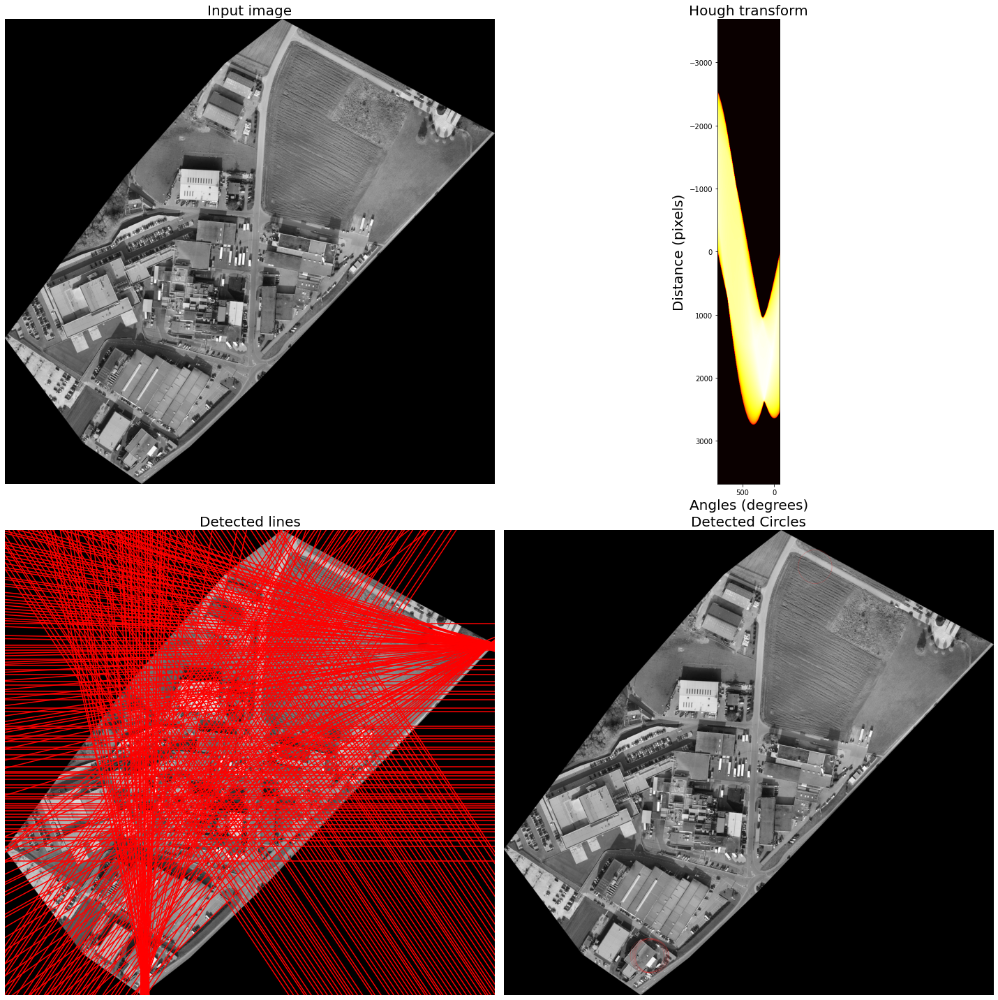

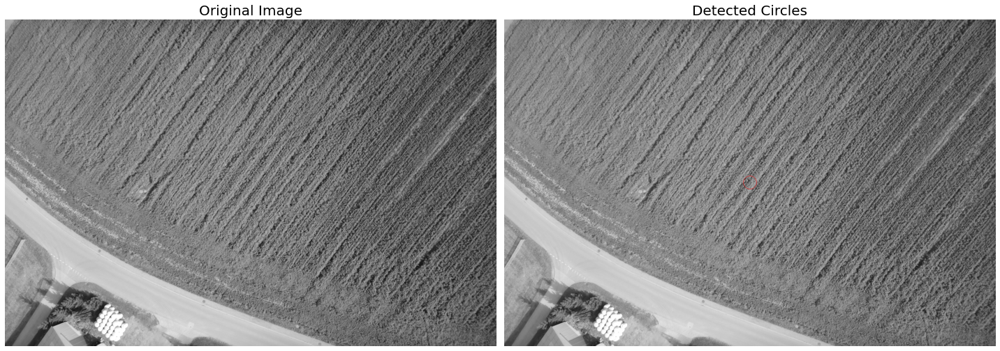

In [ ]:
image = rgb2gray(imread('/content/Data_set/small_map.jpg'))

# Classic straight-line Hough transform
h, theta, d = hough_line(image)

# Generating figure 1
fig, axes = plt.subplots(2, 2, figsize=(20, 20))
ax = axes.ravel()

ax[0].imshow(image, cmap=cm.gray)
ax[0].set_title('Input image', size=20)
ax[0].set_axis_off()

ax[1].imshow(np.log(1 + h),
             extent=[10*np.rad2deg(theta[-1]), np.rad2deg(theta[0]), d[-1], d[0]],
             cmap=cm.hot, aspect=1/1.5)
ax[1].set_title('Hough transform', size=20)
ax[1].set_xlabel('Angles (degrees)', size=20)
ax[1].set_ylabel('Distance (pixels)', size=20)
ax[1].axis('image')

ax[2].imshow(image, cmap=cm.gray)
for _, angle, dist in zip(*hough_line_peaks(h, theta, d)):
    y0 = (dist - 0 * np.cos(angle)) / np.sin(angle)
    y1 = (dist - image.shape[1] * np.cos(angle)) / np.sin(angle)
    ax[2].plot((0, image.shape[1]), (y0, y1), '-r')
ax[2].set_xlim((0, image.shape[1]))
ax[2].set_ylim((image.shape[0], 0))
ax[2].set_axis_off()
ax[2].set_title('Detected lines', size=20)

hough_radii = np.arange(50, 100, 2)
hough_res = hough_circle(image, hough_radii)

# Select the most prominent 5 circles
accums, cx, cy, radii = hough_circle_peaks(hough_res, hough_radii, total_num_peaks=6)

image = gray2rgb(image)
for center_y, center_x, radius in zip(cy, cx, radii):
    circy, circx = circle_perimeter(center_y, center_x, radius)
    image[circy, circx] = (0.9, 0.2, 0.2)

ax[3].imshow(image, cmap=plt.cm.gray)
ax[3].set_axis_off()
ax[3].set_title('Detected Circles', size=20)

plt.tight_layout()
plt.show()

image = rgb2gray(imread('/content/Data_set/RGB Images/EP-00-00012_0119_0070.JPG'))

fig, axes = plt.subplots(1, 2, figsize=(20, 10), sharex=True, sharey=True)
ax = axes.ravel()

ax[0].imshow(image, cmap=plt.cm.gray)
ax[0].set_axis_off()
ax[0].set_title('Original Image', size=20)

hough_radii = np.arange(65, 75, 1)
hough_res = hough_circle(image, hough_radii)

# Select the most prominent 5 circles
accums, cx, cy, radii = hough_circle_peaks(hough_res, hough_radii, total_num_peaks=4)

image = gray2rgb(image)
for center_y, center_x, radius in zip(cy, cx, radii):
    circy, circx = circle_perimeter(center_y, center_x, radius)
    image[circy, circx] = (1, 0, 0)

ax[1].imshow(image, cmap=plt.cm.gray)
ax[1].set_axis_off()
ax[1].set_title('Detected Circles', size=20)

plt.tight_layout()
plt.show()

#### graph-based image segmentation

In [ ]:
from skimage.data import astronaut
from skimage.io import imread
from skimage.color import rgb2gray
from skimage.filters import sobel
from skimage.segmentation import felzenszwalb, slic, quickshift, watershed
from skimage.segmentation import mark_boundaries, find_boundaries
from skimage.util import img_as_float

/usr/local/lib/python3.6/dist-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/usr/local/lib/python3.6/dist-packages/numpy/core/_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


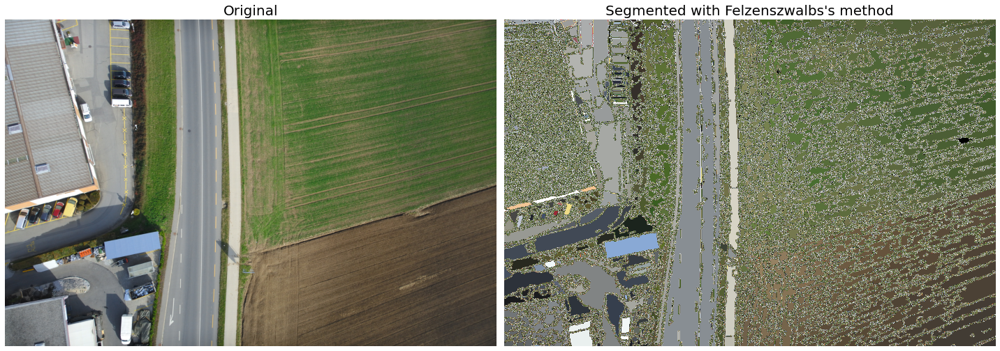

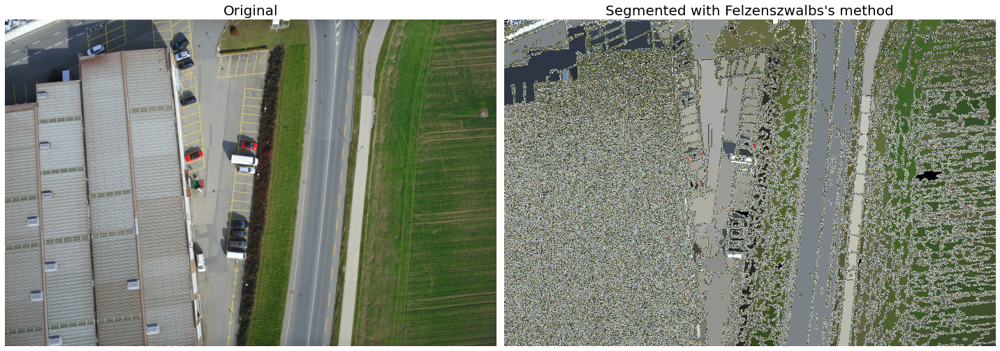

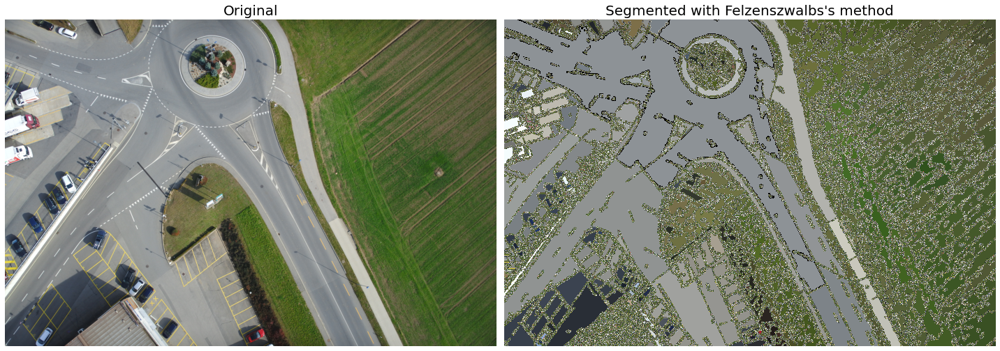

In [ ]:
from matplotlib.colors import LinearSegmentedColormap
for imfile in ['/content/Data_set/RGB Images/EP-00-00012_0119_0001.JPG', '/content/Data_set/RGB Images/EP-00-00012_0119_0002.JPG', '/content/Data_set/RGB Images/EP-00-00012_0119_0003.JPG', '/content/Data_set/RGB Images/EP-00-00012_0119_0005.JPG']:
    img = img_as_float(imread(imfile)[::2, ::2, :3])
    plt.figure(figsize=(20,10))
    segments_fz = felzenszwalb(img, scale=100, sigma=0.5, min_size=100) #300
    borders = find_boundaries(segments_fz)
    unique_colors = np.unique(segments_fz.ravel())
    segments_fz[borders] = -1 #len(unique_colors)
    colors = [np.zeros(3)]
    for color in unique_colors:
        colors.append(np.mean(img[segments_fz == color], axis=0))    
    cm = LinearSegmentedColormap.from_list('pallete', colors, N=len(colors))
    plt.subplot(121)
    plt.imshow(img)
    plt.title('Original', size=20)
    plt.axis('off') 
    plt.subplot(122)
    plt.imshow(segments_fz, cmap=cm)
    plt.title('Segmented with Felzenszwalbs\'s method', size=20)
    plt.axis('off')   
    plt.tight_layout()
    plt.show()

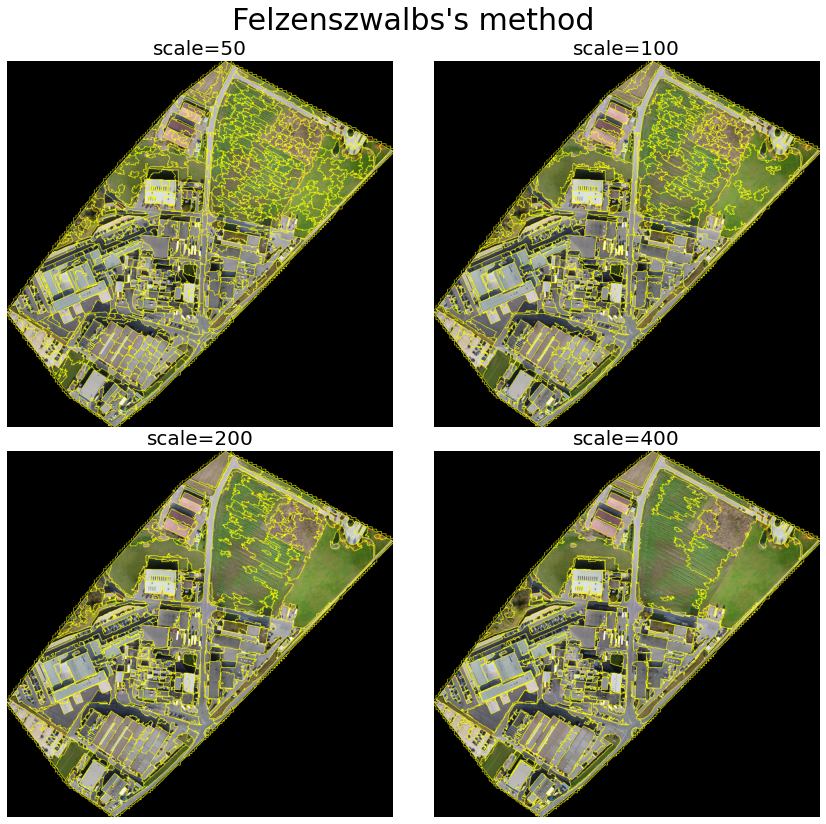

In [ ]:
def plot_image(img, title):
    plt.imshow(img)
    plt.title(title, size=20)
    plt.axis('off')    
    
img = imread('/content/Data_set/small_map.jpg')[::2, ::2, :3] #img_as_float(astronaut()[::2, ::2])

plt.figure(figsize=(12,12))
i = 1
for scale in [50, 100, 200, 400]:
    plt.subplot(2,2,i)
    segments_fz = felzenszwalb(img, scale=scale, sigma=0.5, min_size=200)
    plot_image(mark_boundaries(img, segments_fz), 'scale=' + str(scale))
    i += 1
plt.suptitle('Felzenszwalbs\'s method', size=30)
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

#### Region growing 

In [ ]:
!pip install SimpleITK

     |████████████████████████████████| 47.4MB 85kB/s 


In [ ]:
import SimpleITK as sitk
def show_image(img, title=None):
    nda = sitk.GetArrayViewFromImage(img)
    #nda = np.transpose(nda, (1, 2, 0))
    #print(nda.shape)
    plt.imshow(nda, cmap='gray')   
    plt.axis('off')
    if(title):
        plt.title(title, size=20)

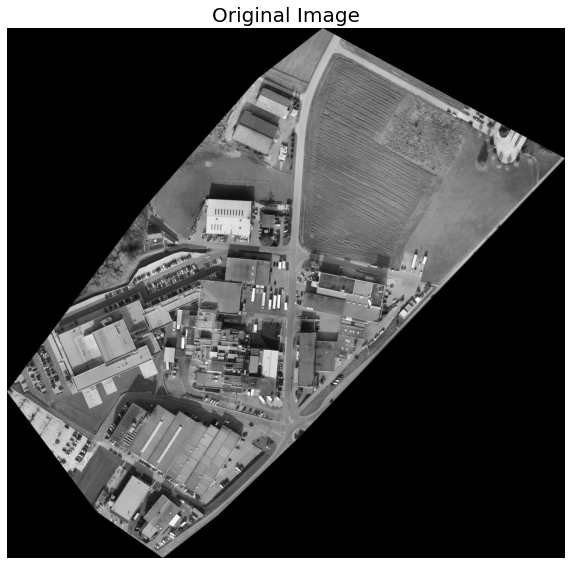

In [ ]:
img = 255*rgb2gray(imread('/content/Data_set/small_map.png'))
#img = np.transpose(img, (2, 0, 1))
img_T1 = sitk.GetImageFromArray(img) 
img_T1_255 = sitk.Cast(sitk.RescaleIntensity(img_T1), sitk.sitkUInt8)
#print(img_T1.GetSize())
#nda = sitk.GetArrayViewFromImage(img_T1)
#print(nda.shape, nda.ndim)
plt.figure(figsize=(10,10))
show_image(img_T1, "Original Image")

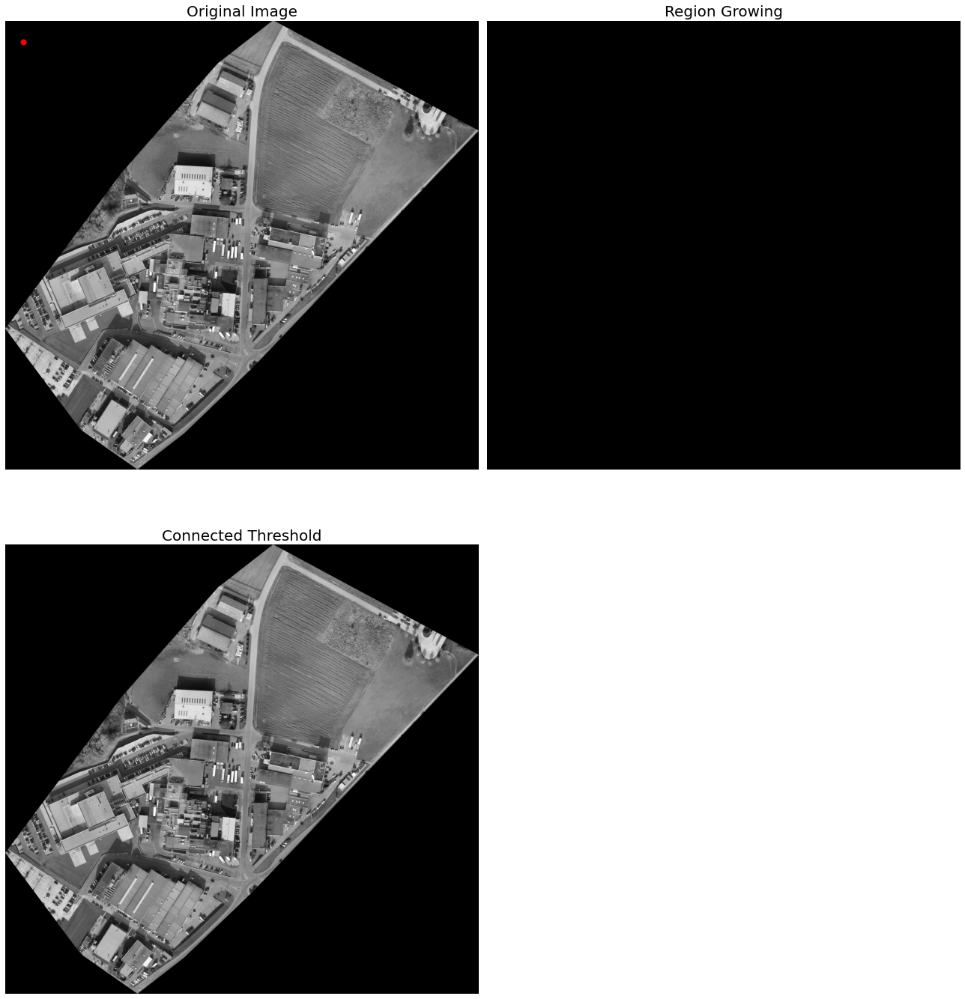

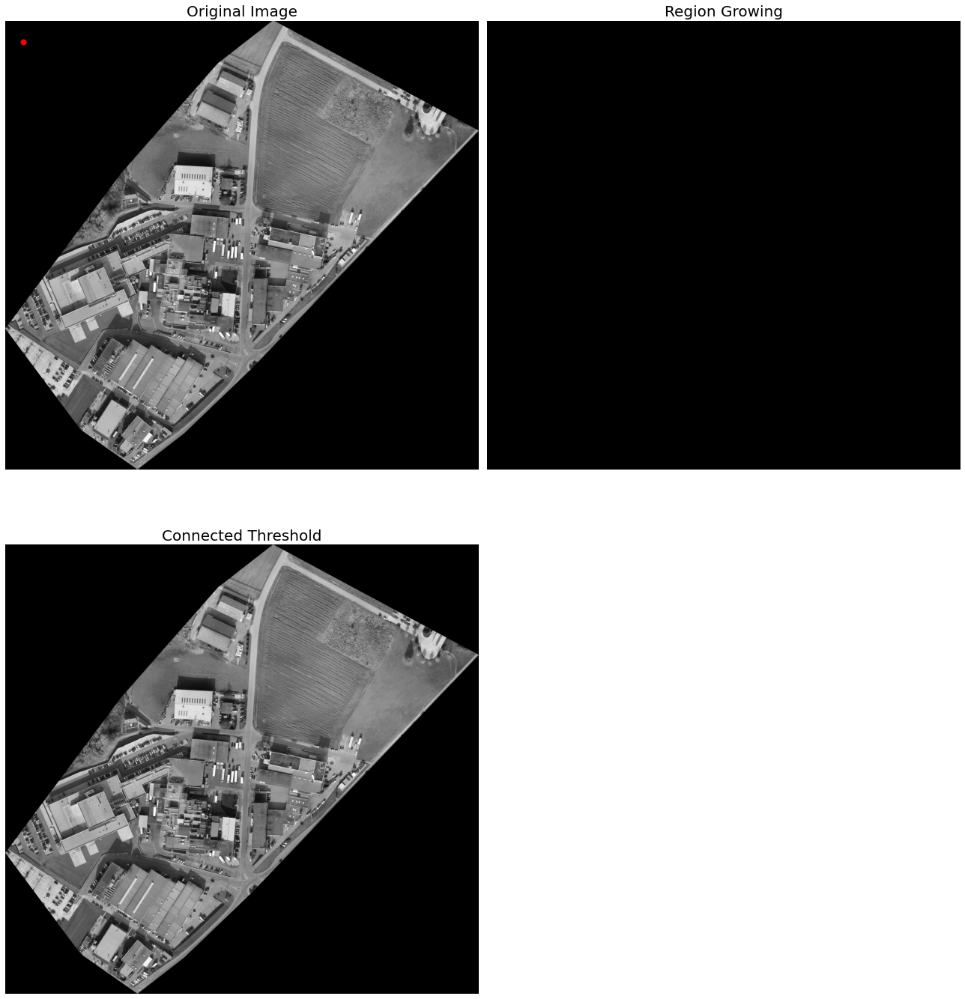

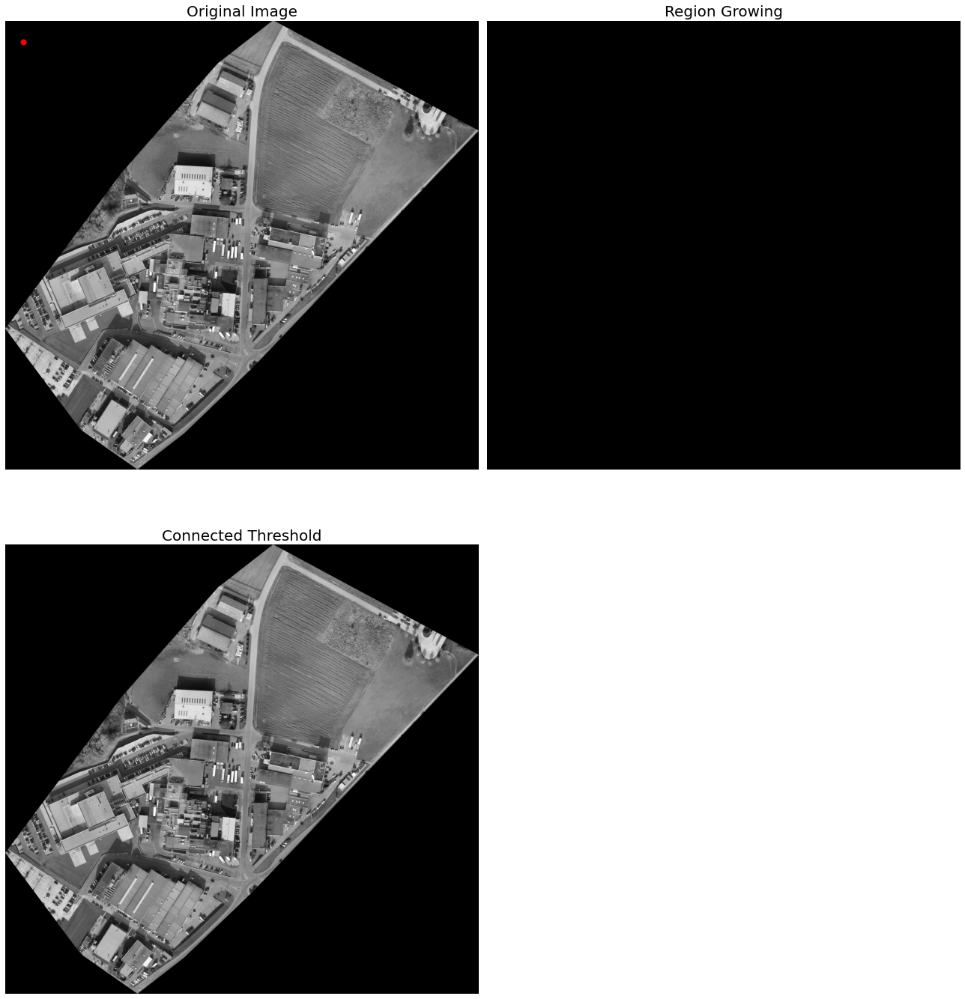

In [ ]:
seed = (100,120)
for upper in [80, 85, 90]:
    plt.figure(figsize=(18,20))
    plt.subplot(221)
    show_image(img_T1, "Original Image")
    plt.scatter(seed[0], seed[1], color='red', s=50)
    plt.subplot(222)
    seg = sitk.ConnectedThreshold(img_T1, seedList=[seed], lower=40, upper=upper)
    show_image(seg, "Region Growing")
    plt.subplot(223)
    show_image(sitk.LabelOverlay(img_T1_255, seg), "Connected Threshold")
    plt.axis('off')
    plt.tight_layout()
    plt.show()

### Morphological snakes

In [ ]:
from skimage.data import astronaut
from skimage.io import imread
from skimage.color import rgb2gray
from skimage.filters import sobel
from skimage.segmentation import felzenszwalb, slic, quickshift, watershed
from skimage.segmentation import mark_boundaries, find_boundaries
from skimage.util import img_as_float
import numpy as np

from skimage.transform import (hough_line, hough_line_peaks, hough_circle, hough_circle_peaks)
from skimage.draw import circle_perimeter
from skimage.feature import canny
from skimage.data import astronaut
from skimage.io import imread, imsave
from skimage.color import rgb2gray, gray2rgb, label2rgb
from skimage import img_as_float
from skimage.morphology import skeletonize
from skimage import data, img_as_float
import matplotlib.pyplot as plt
from matplotlib import cm
from skimage.filters import sobel, threshold_otsu
from skimage.feature import canny
from skimage.segmentation import felzenszwalb, slic, quickshift, watershed
from skimage.segmentation import mark_boundaries, find_boundaries

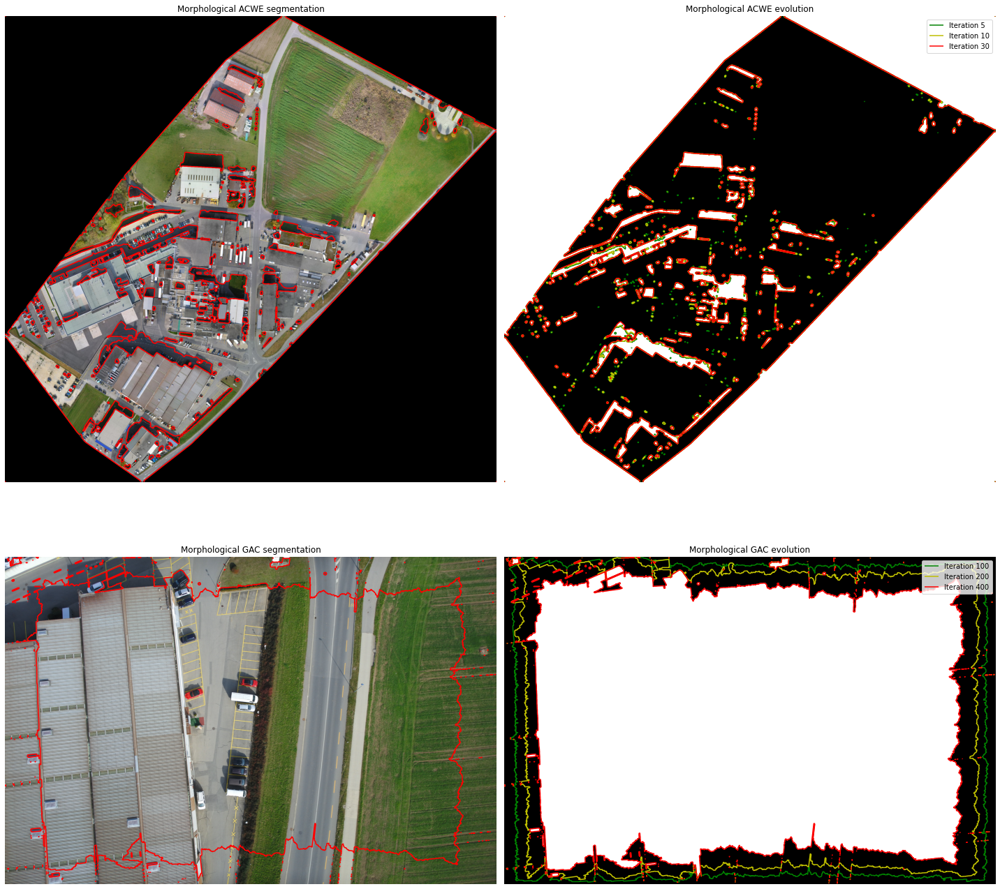

(None, None)

In [ ]:
from skimage.segmentation import (morphological_chan_vese, morphological_geodesic_active_contour,
                                  inverse_gaussian_gradient, checkerboard_level_set)

def store_evolution_in(lst):
    """Returns a callback function to store the evolution of the level sets in
    the given list.
    """

    def _store(x):
        lst.append(np.copy(x))
       
    return _store

# Morphological ACWE
image = imread('/content/Data_set/small_map.jpg')
image_gray = rgb2gray(image)
# initial level set
init_lvl_set = checkerboard_level_set(image_gray.shape, 6)
# list with intermediate results for plotting the evolution
evolution = []
callback = store_evolution_in(evolution)
lvl_set = morphological_chan_vese(image_gray, 30, init_level_set=init_lvl_set, smoothing=3, iter_callback=callback)

fig, axes = plt.subplots(2, 2, figsize=(20, 20))
axes = axes.flatten()
axes[0].imshow(image, cmap="gray"), axes[0].set_axis_off(),
axes[0].contour(lvl_set, [0.5], colors='r')
axes[0].set_title("Morphological ACWE segmentation", fontsize=12)
axes[1].imshow(lvl_set, cmap="gray"), axes[1].set_axis_off()
contour = axes[1].contour(evolution[5], [0.5], colors='g')
contour.collections[0].set_label("Iteration 5")
contour = axes[1].contour(evolution[10], [0.5], colors='y')
contour.collections[0].set_label("Iteration 10")
contour = axes[1].contour(evolution[-1], [0.5], colors='r')
contour.collections[0].set_label("Iteration " + str(len(evolution)-1))
axes[1].legend(loc="upper right"), axes[1].set_title("Morphological ACWE evolution", fontsize=12)
                                                     
# Morphological GAC
image = imread('/content/Data_set/RGB Images/EP-00-00012_0119_0002.JPG')
image_gray = rgb2gray(image)
gimage = inverse_gaussian_gradient(image_gray)
# initial level set
init_lvl_set = np.zeros(image_gray.shape, dtype=np.int8)
init_lvl_set[10:-10, 10:-10] = 1
# list with intermediate results for plotting the evolution
evolution = []
callback = store_evolution_in(evolution)
lvl_set = morphological_geodesic_active_contour(gimage, 400, init_lvl_set, smoothing=1, balloon=-1, threshold=0.7, iter_callback=callback)
axes[2].imshow(image, cmap="gray"), axes[2].set_axis_off(),
axes[2].contour(lvl_set, [0.5], colors='r')
axes[2].set_title("Morphological GAC segmentation", fontsize=12)
axes[3].imshow(lvl_set, cmap="gray"), axes[3].set_axis_off()
contour = axes[3].contour(evolution[100], [0.5], colors='g')
contour.collections[0].set_label("Iteration 100")
contour = axes[3].contour(evolution[200], [0.5], colors='y')
contour.collections[0].set_label("Iteration 200")
contour = axes[3].contour(evolution[-1], [0.5], colors='r')
contour.collections[0].set_label("Iteration " + str(len(evolution)-1))
axes[3].legend(loc="upper right"), axes[3].set_title("Morphological GAC evolution", fontsize=12)
fig.tight_layout(), plt.show()

#### Edges-based/region-based segmentation

In [ ]:
from osgeo import gdal
import numpy as np
ds = gdal.Open("/content/Data_set/small_map.jpg")
coins = np.array(ds.GetRasterBand(1).ReadAsArray())
coins.shape

(2538, 2674)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: VisibleDeprecationWarning: Passing `normed=True` on non-uniform bins has always been broken, and computes neither the probability density function nor the probability mass function. The result is only correct if the bins are uniform, when density=True will produce the same result anyway. The argument will be removed in a future version of numpy.
  This is separate from the ipykernel package so we can avoid doing imports until


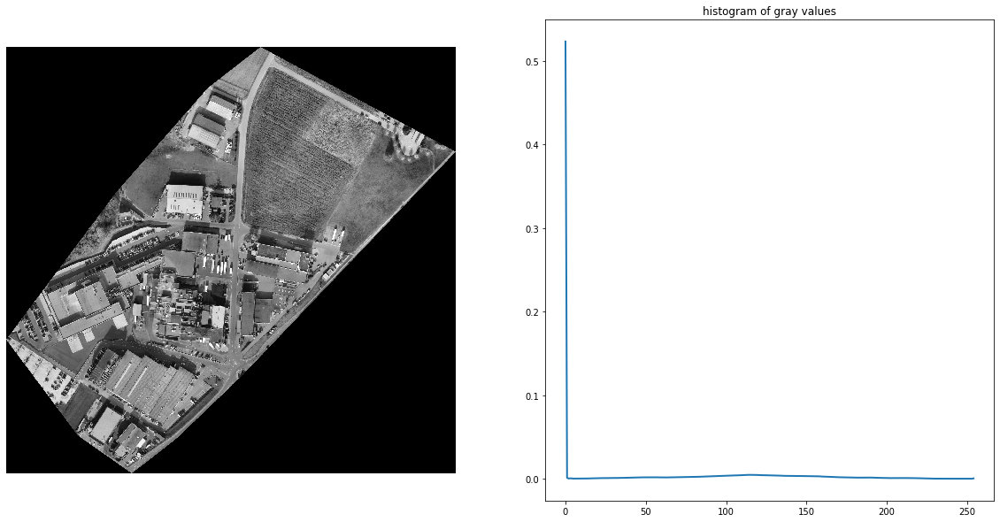

In [ ]:


hist = np.histogram(coins, bins=np.arange(0, 256), normed=True)
#print(hist)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
axes[0].imshow(coins, cmap=plt.cm.gray, interpolation='nearest')
axes[0].axis('off')
axes[1].plot(hist[1][:-1], hist[0], lw=2)
axes[1].set_title('histogram of gray values')
plt.show()

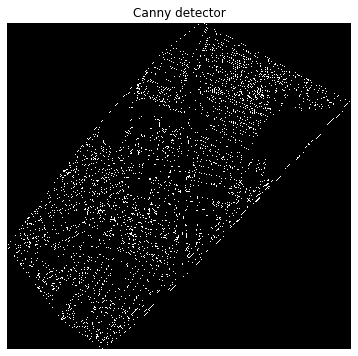

In [ ]:
edges = canny(coins, sigma=2)

fig, ax = plt.subplots(figsize=(10, 6))
ax.imshow(edges, cmap=plt.cm.gray, interpolation='nearest')
ax.set_title('Canny detector')
ax.axis('off')
plt.show()

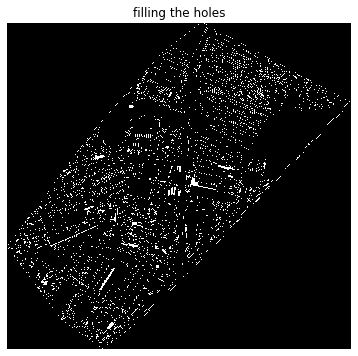

In [ ]:
from scipy import ndimage as ndi

fill_coins = ndi.binary_fill_holes(edges)

fig, ax = plt.subplots(figsize=(10, 6))
ax.imshow(fill_coins, cmap=plt.cm.gray, interpolation='nearest')
ax.set_title('filling the holes')
ax.axis('off')
plt.show()

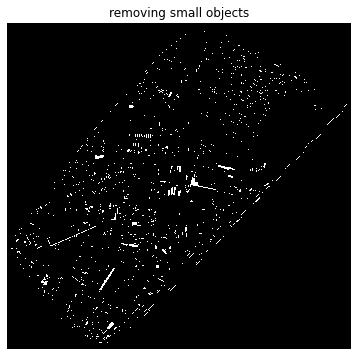

In [ ]:
from skimage import morphology

coins_cleaned = morphology.remove_small_objects(fill_coins, 21)

fig, ax = plt.subplots(figsize=(10, 6))
ax.imshow(coins_cleaned, cmap=plt.cm.gray, interpolation='nearest')
ax.set_title('removing small objects')
ax.axis('off')
plt.show()

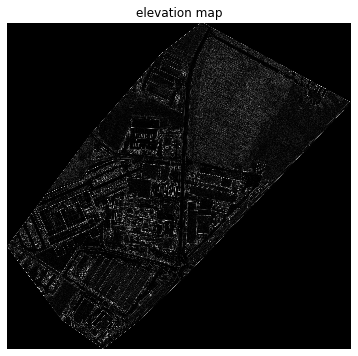

(2538, 2674)


In [ ]:
from skimage.filters import sobel

elevation_map = sobel(coins)

fig, ax = plt.subplots(figsize=(10, 6))
ax.imshow(elevation_map, cmap=plt.cm.gray, interpolation='nearest')
ax.set_title('elevation map')
ax.axis('off')
plt.show()
print(elevation_map.shape)

2 0


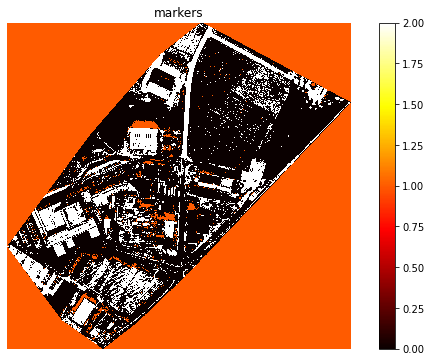

In [ ]:
markers = np.zeros_like(coins)
markers[coins < 30] = 1
markers[coins > 150] = 2
print(np.max(markers), np.min(markers))

fig, ax = plt.subplots(figsize=(10, 6))
a = ax.imshow(markers, cmap=plt.cm.hot, interpolation='nearest')
plt.colorbar(a)
ax.set_title('markers')
ax.axis('off')
plt.show()

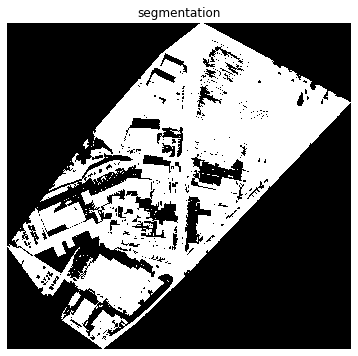

In [ ]:
segmentation = morphology.watershed(elevation_map, markers)

fig, ax = plt.subplots(figsize=(10, 6))
ax.imshow(segmentation, cmap=plt.cm.gray, interpolation='nearest')
ax.set_title('segmentation')
ax.axis('off')
plt.show()

[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108]


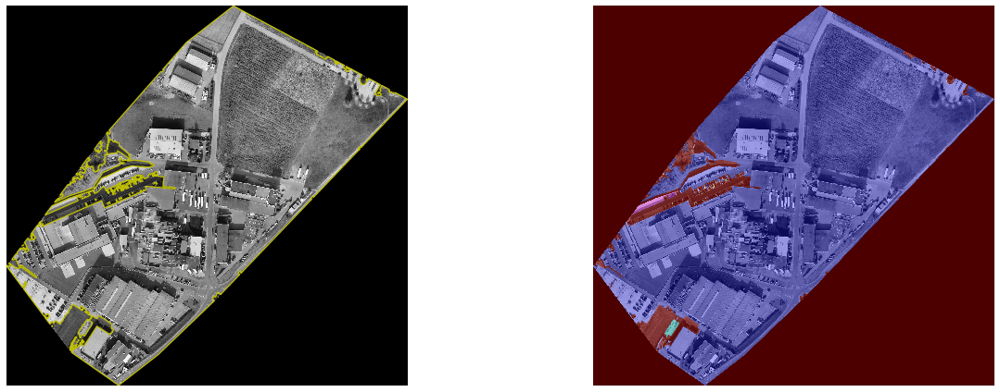

In [ ]:
from skimage.color import label2rgb

segmentation = ndi.binary_fill_holes(segmentation - 1)
labeled_coins, _ = ndi.label(segmentation)
print(np.unique(labeled_coins))
image_label_overlay = label2rgb(labeled_coins, image=coins)

fig, axes = plt.subplots(1, 2, figsize=(20, 6), sharey=True)
axes[0].imshow(coins, cmap=plt.cm.gray, interpolation='nearest')
axes[0].contour(segmentation, [0.5], linewidths=1.2, colors='y')
axes[1].imshow(image_label_overlay, interpolation='nearest')

for a in axes:
    a.axis('off')

plt.tight_layout()

plt.show()